In [5]:
import torch
import open3d as o3d
import matplotlib.pyplot as plt
from src.constants import LOG_PROTO_PATH, MODEL_CHECKPOINT_FILE, DEFAULT_IMAGE_MEAN, DEFAULT_IMAGE_STD_DEV
from src.utils import (
    get_random_scene_name, 
    get_random_image_file, 
    get_images_given_rbg_image_file, 
    get_tensor_from_numpy_image, 
    get_numpy_image_from_tensor_descriptor, 
    get_random_pixel_from_mask_image,
    get_random_custom_image,
    get_random_custom_image_multi
)
from src.viz import draw_geometries
from src.dcn import DenseCorrespondenceNetwork
from src.resnet_34_8s import Resnet34_8s
from src.plotting import normalize_descriptor, draw_reticle_cv2, normalize_descriptor_pair
from torchvision import transforms
import matplotlib.gridspec as gridspec
import numpy as np

## Data Visualization

In [2]:
scene_name = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file = get_random_image_file(LOG_PROTO_PATH, scene_name)
scene_name, rgb_image_file

('2018-05-14-22-19-06', '001830_rgb.png')

In [3]:
rgb, depth, mask, depth_cropped, fusion_pointcloud_file = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name, rgb_image_file)

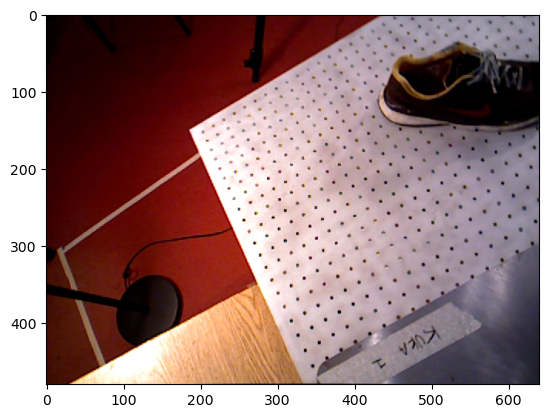

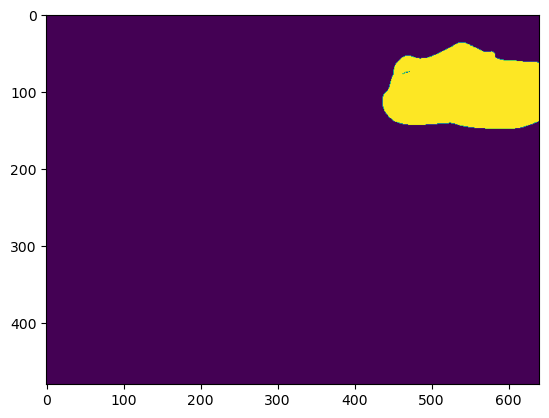

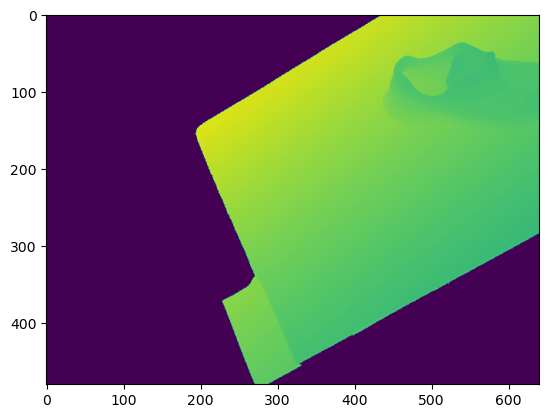

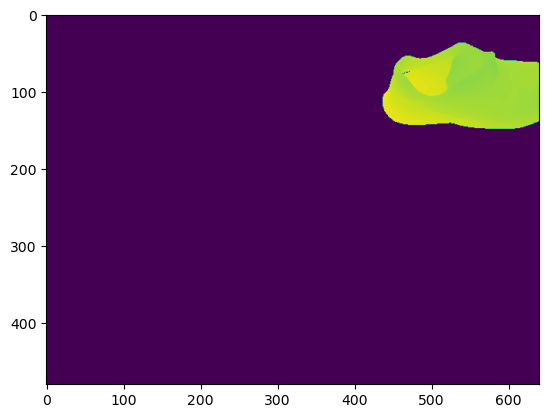

In [4]:
plt.imshow(rgb)
plt.show()
plt.imshow(mask)
plt.show()
plt.imshow(depth)
plt.show()
plt.imshow(depth_cropped)
plt.show()

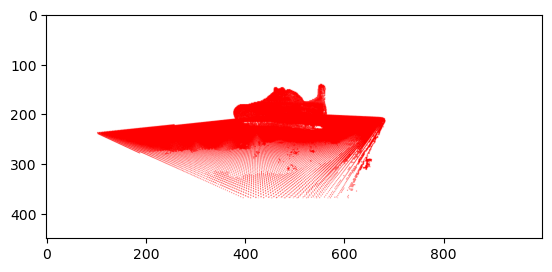

In [5]:
plt.imshow(plt.imread('newplot.png'))

In [6]:
point_cloud = o3d.io.read_point_cloud(fusion_pointcloud_file)
draw_geometries([point_cloud])

## Load Model

In [2]:
resnet_model = Resnet34_8s(3)
dcn = DenseCorrespondenceNetwork(resnet_model, 3, normalize=True)
state_dict = torch.load(MODEL_CHECKPOINT_FILE, map_location='cpu')
dcn.load_state_dict(state_dict)
dcn.eval()

image_transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize(DEFAULT_IMAGE_MEAN, DEFAULT_IMAGE_STD_DEV)])

## Descriptor Visualization - Single

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


/Users/gunjanchhablani/opt/anaconda3/envs/don_shoe_env/lib/python3.8/site-packages/torch/nn/functional.py:2589: UserWarning:

nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


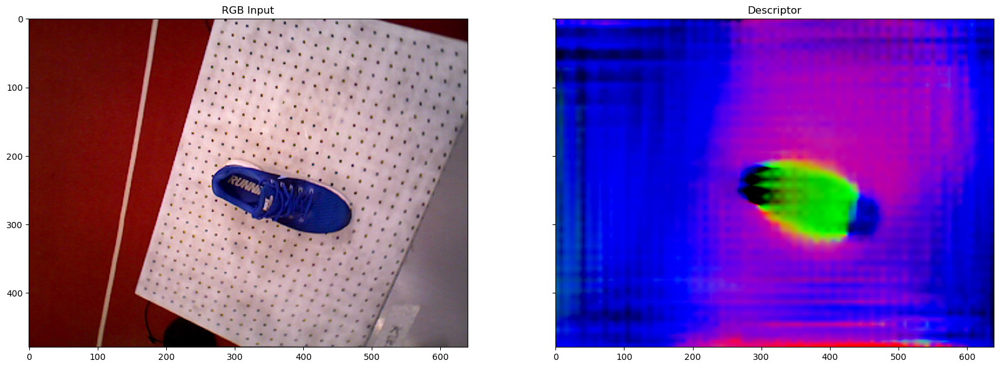

In [8]:
scene_name = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file = get_random_image_file(LOG_PROTO_PATH, scene_name)
rgb, depth, mask, depth_cropped, fusion_pointcloud_file = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name, rgb_image_file)
input = get_tensor_from_numpy_image(rgb, image_transform)
with torch.no_grad():
    output = dcn(input)

output_descriptor = get_numpy_image_from_tensor_descriptor(output)

f, (ax1, ax2) = plt.subplots(1, 2, sharey=True)
ax1.imshow(rgb)
ax1.set_title("RGB Input")
ax2.imshow(output_descriptor)
ax2.set_title("Descriptor")
f.set_size_inches((20,10))
plt.show()

## Descriptor Visualization - Random Pair of Images, Random Scenes
We pick a random pixel based on the mask image and find the corresponding one in the second image.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


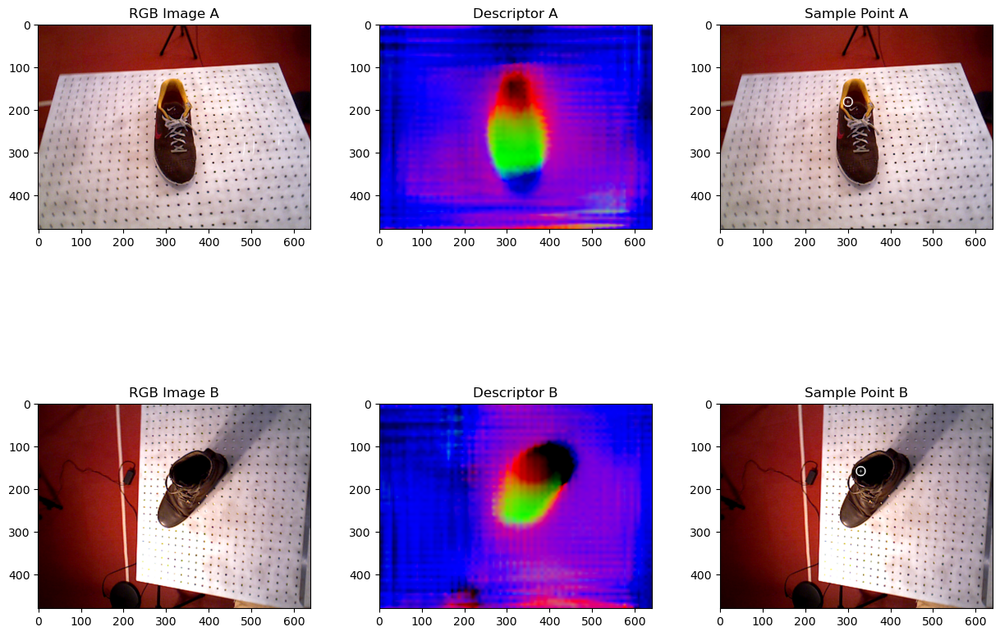

In [29]:
import numpy as np

scene_name_a = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file_a = get_random_image_file(LOG_PROTO_PATH, scene_name_a)

scene_name_b = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file_b = get_random_image_file(LOG_PROTO_PATH, scene_name_b)

rgb_a, depth_a, mask_a, depth_cropped_a, fusion_pointcloud_file_a = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_a, rgb_image_file_a)
rgb_b, depth_b, mask_b, depth_cropped_b, fusion_pointcloud_file_b = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_b, rgb_image_file_b)

input_a = get_tensor_from_numpy_image(rgb_a, image_transform)
with torch.no_grad():
    output_a = dcn(input_a)

output_descriptor_a = get_numpy_image_from_tensor_descriptor(output_a)

input_b = get_tensor_from_numpy_image(rgb_b, image_transform)
with torch.no_grad():
    output_b = dcn(input_b)

output_descriptor_b = get_numpy_image_from_tensor_descriptor(output_b)

coordinates_a = get_random_pixel_from_mask_image(mask_a)
descriptor_a = output_descriptor_a[coordinates_a[0], coordinates_a[1], :]

dot_product = output_descriptor_b.dot(descriptor_a)
coordinates_b = np.transpose(np.nonzero(dot_product==np.max(dot_product)))[0]

reticle_a = draw_reticle_cv2(rgb_a, coordinates_a[1], coordinates_a[0], label_color=[255, 255, 255])
reticle_b = draw_reticle_cv2(rgb_b, coordinates_b[1], coordinates_b[0], label_color=[255, 255, 255])

# fig, axes = plt.subplots(2, 3)

# axes[0, 0].imshow(rgb_a)
# axes[0, 0].set_title("RGB Image A")
# axes[0, 1].imshow(output_descriptor_a)
# axes[0, 1].set_title("Descriptor A")
# axes[0, 2].imshow(reticle_a)
# axes[0, 2].set_title("Sample Point A")
# axes[1, 0].imshow(rgb_b)
# axes[1, 0].set_title("RGB Image B")
# axes[1, 1].imshow(output_descriptor_b)
# axes[1, 1].set_title("Descriptor B")
# axes[1, 2].imshow(reticle_b)
# axes[1, 2].set_title("Sample Point B")

fig = plt.figure()
gs1 = gridspec.GridSpec(2, 3)
gs1.update(wspace=0.25, hspace=0.5) # set the spacing between axes. 

ax1 = plt.subplot(gs1[0])
ax1.imshow(rgb_a)
ax1.set_title("RGB Image A")

ax2 = plt.subplot(gs1[1])
ax2.imshow(output_descriptor_a)
ax2.set_title("Descriptor A")

ax3 = plt.subplot(gs1[2])
ax3.imshow(reticle_a)
ax3.set_title("Sample Point A")

ax4 = plt.subplot(gs1[3])
ax4.imshow(rgb_b)
ax4.set_title("RGB Image B")

ax5 = plt.subplot(gs1[4])
ax5.imshow(output_descriptor_b)
ax5.set_title("Descriptor B")

ax6 = plt.subplot(gs1[5])
ax6.imshow(reticle_b)
ax6.set_title("Sample Point B")

plt.axis('on')
fig.set_size_inches([15,10])
plt.show()

In [10]:
# plt.imshow(rgb_a[coordinates_a[0]-50:coordinates_a[0]+50, coordinates_a[1]-50:coordinates_a[1]+50])

## Descriptor Visualization - Random Pair of Images, Same Scenes

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


/Users/gunjanchhablani/opt/anaconda3/envs/don_shoe_env/lib/python3.8/site-packages/torch/nn/functional.py:2589: UserWarning: nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.")
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


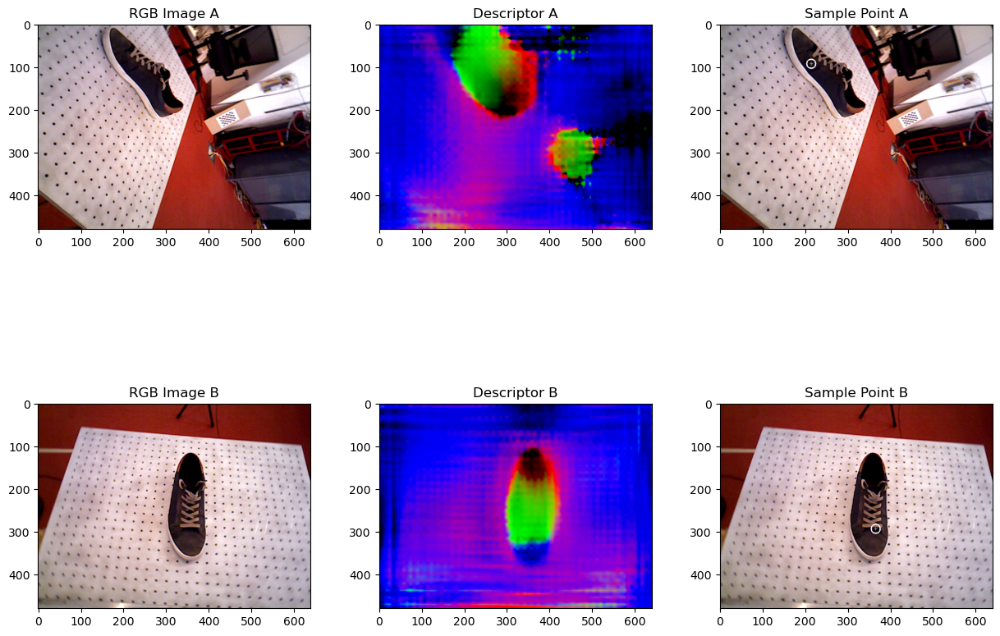

In [3]:
import numpy as np

scene_name_a = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file_a = get_random_image_file(LOG_PROTO_PATH, scene_name_a)

scene_name_b = scene_name_a
rgb_image_file_b = get_random_image_file(LOG_PROTO_PATH, scene_name_b)

rgb_a, depth_a, mask_a, depth_cropped_a, fusion_pointcloud_file_a = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_a, rgb_image_file_a)
rgb_b, depth_b, mask_b, depth_cropped_b, fusion_pointcloud_file_b = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_b, rgb_image_file_b)

input_a = get_tensor_from_numpy_image(rgb_a, image_transform)
with torch.no_grad():
    output_a = dcn(input_a)

output_descriptor_a = get_numpy_image_from_tensor_descriptor(output_a)

input_b = get_tensor_from_numpy_image(rgb_b, image_transform)
with torch.no_grad():
    output_b = dcn(input_b)

output_descriptor_b = get_numpy_image_from_tensor_descriptor(output_b)

coordinates_a = get_random_pixel_from_mask_image(mask_a)
descriptor_a = output_descriptor_a[coordinates_a[0], coordinates_a[1], :]

dot_product = output_descriptor_b.dot(descriptor_a)
coordinates_b = np.transpose(np.nonzero(dot_product==np.max(dot_product)))[0]

reticle_a = draw_reticle_cv2(rgb_a, coordinates_a[1], coordinates_a[0], label_color=[255, 255, 255])
reticle_b = draw_reticle_cv2(rgb_b, coordinates_b[1], coordinates_b[0], label_color=[255, 255, 255])

# fig, axes = plt.subplots(2, 3)

# axes[0, 0].imshow(rgb_a)
# axes[0, 0].set_title("RGB Image A")
# axes[0, 1].imshow(output_descriptor_a)
# axes[0, 1].set_title("Descriptor A")
# axes[0, 2].imshow(reticle_a)
# axes[0, 2].set_title("Sample Point A")
# axes[1, 0].imshow(rgb_b)
# axes[1, 0].set_title("RGB Image B")
# axes[1, 1].imshow(output_descriptor_b)
# axes[1, 1].set_title("Descriptor B")
# axes[1, 2].imshow(reticle_b)
# axes[1, 2].set_title("Sample Point B")

fig = plt.figure()
gs1 = gridspec.GridSpec(2, 3)
gs1.update(wspace=0.25, hspace=0.5) # set the spacing between axes. 

ax1 = plt.subplot(gs1[0])
ax1.imshow(rgb_a)
ax1.set_title("RGB Image A")

ax2 = plt.subplot(gs1[1])
ax2.imshow(output_descriptor_a)
ax2.set_title("Descriptor A")

ax3 = plt.subplot(gs1[2])
ax3.imshow(reticle_a)
ax3.set_title("Sample Point A")

ax4 = plt.subplot(gs1[3])
ax4.imshow(rgb_b)
ax4.set_title("RGB Image B")

ax5 = plt.subplot(gs1[4])
ax5.imshow(output_descriptor_b)
ax5.set_title("Descriptor B")

ax6 = plt.subplot(gs1[5])
ax6.imshow(reticle_b)
ax6.set_title("Sample Point B")

plt.axis('on')
fig.set_size_inches([15,10])
plt.show()

## Descriptor Visualization - Random Pair of Images (Dataset, Custom) - Single

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


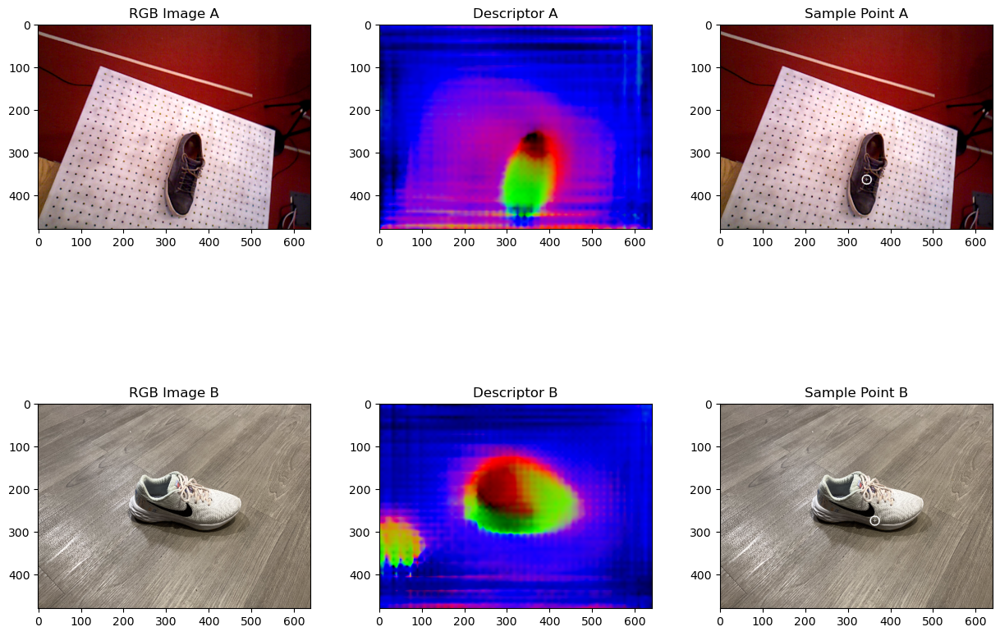

In [24]:
scene_name_a = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file_a = get_random_image_file(LOG_PROTO_PATH, scene_name_a)

# scene_name_b = scene_name_a
# rgb_image_file_b = get_random_image_file(LOG_PROTO_PATH, scene_name_b)

rgb_a, depth_a, mask_a, depth_cropped_a, fusion_pointcloud_file_a = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_a, rgb_image_file_a)
# rgb_b, depth_b, mask_b, depth_cropped_b, fusion_pointcloud_file_b = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_b, rgb_image_file_b)

rgb_b = get_random_custom_image()
input_a = get_tensor_from_numpy_image(rgb_a, image_transform)
with torch.no_grad():
    output_a = dcn(input_a)

output_descriptor_a = get_numpy_image_from_tensor_descriptor(output_a)

input_b = get_tensor_from_numpy_image(rgb_b, image_transform)
with torch.no_grad():
    output_b = dcn(input_b)

output_descriptor_b = get_numpy_image_from_tensor_descriptor(output_b)

coordinates_a = get_random_pixel_from_mask_image(mask_a)
descriptor_a = output_descriptor_a[coordinates_a[0], coordinates_a[1], :]

dot_product = output_descriptor_b.dot(descriptor_a)
# Finding multiple
coordinates_b = np.transpose(np.nonzero(dot_product==np.max(dot_product)))[0]

reticle_a = draw_reticle_cv2(rgb_a, coordinates_a[1], coordinates_a[0], label_color=[255, 255, 255])
reticle_b = draw_reticle_cv2(rgb_b, coordinates_b[1], coordinates_b[0], label_color=[255, 255, 255])

# fig, axes = plt.subplots(2, 3)

# axes[0, 0].imshow(rgb_a)
# axes[0, 0].set_title("RGB Image A")
# axes[0, 1].imshow(output_descriptor_a)
# axes[0, 1].set_title("Descriptor A")
# axes[0, 2].imshow(reticle_a)
# axes[0, 2].set_title("Sample Point A")
# axes[1, 0].imshow(rgb_b)
# axes[1, 0].set_title("RGB Image B")
# axes[1, 1].imshow(output_descriptor_b)
# axes[1, 1].set_title("Descriptor B")
# axes[1, 2].imshow(reticle_b)
# axes[1, 2].set_title("Sample Point B")

fig = plt.figure()
gs1 = gridspec.GridSpec(2, 3)
gs1.update(wspace=0.25, hspace=0.5) # set the spacing between axes. 

ax1 = plt.subplot(gs1[0])
ax1.imshow(rgb_a)
ax1.set_title("RGB Image A")

ax2 = plt.subplot(gs1[1])
ax2.imshow(output_descriptor_a)
ax2.set_title("Descriptor A")

ax3 = plt.subplot(gs1[2])
ax3.imshow(reticle_a)
ax3.set_title("Sample Point A")

ax4 = plt.subplot(gs1[3])
ax4.imshow(rgb_b)
ax4.set_title("RGB Image B")

ax5 = plt.subplot(gs1[4])
ax5.imshow(output_descriptor_b)
ax5.set_title("Descriptor B")

ax6 = plt.subplot(gs1[5])
ax6.imshow(reticle_b)
ax6.set_title("Sample Point B")

plt.axis('on')
fig.set_size_inches([15,10])
plt.show()

## Descriptor Visualization - Random Pair of Images (Dataset, Custom) - Multi

In [28]:
scene_name_a = get_random_scene_name(LOG_PROTO_PATH)
rgb_image_file_a = get_random_image_file(LOG_PROTO_PATH, scene_name_a)

# scene_name_b = scene_name_a
# rgb_image_file_b = get_random_image_file(LOG_PROTO_PATH, scene_name_b)

rgb_a, depth_a, mask_a, depth_cropped_a, fusion_pointcloud_file_a = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_a, rgb_image_file_a)
# rgb_b, depth_b, mask_b, depth_cropped_b, fusion_pointcloud_file_b = get_images_given_rbg_image_file(LOG_PROTO_PATH, scene_name_b, rgb_image_file_b)

rgb_b = get_random_custom_image_multi()
input_a = get_tensor_from_numpy_image(rgb_a, image_transform)
with torch.no_grad():
    output_a = dcn(input_a)

output_descriptor_a = get_numpy_image_from_tensor_descriptor(output_a)

input_b = get_tensor_from_numpy_image(rgb_b, image_transform)
with torch.no_grad():
    output_b = dcn(input_b)

output_descriptor_b = get_numpy_image_from_tensor_descriptor(output_b)

coordinates_a = get_random_pixel_from_mask_image(mask_a)
descriptor_a = output_descriptor_a[coordinates_a[0], coordinates_a[1], :]

dot_product = output_descriptor_b.dot(descriptor_a)
# Finding top 3 coordinates
top_3_values = np.sorted(dot_product, reversed=True)[:3]
coordinates_b_1 = np.transpose(np.nonzero(dot_product==top_3_values[0]))[0]
coordinates_b_2 = np.transpose(np.nonzero(dot_product==top_3_values[1]))[0]
coordinates_b_3 = np.transpose(np.nonzero(dot_product==top_3_values[2]))[0]

reticle_a = draw_reticle_cv2(rgb_a, coordinates_a[1], coordinates_a[0], label_color=[255, 255, 255])
reticle_b = draw_reticle_cv2(rgb_b, coordinates_b_1[1], coordinates_b_1[0], label_color=[255, 0, 0])
reticle_b = draw_reticle_cv2(reticle_b, coordinates_b_2[1], coordinates_b_2[0], label_color=[0, 255, 0])
reticle_b = draw_reticle_cv2(reticle_b, coordinates_b_3[1], coordinates_b_3[0], label_color=[0, 0, 255])

# fig, axes = plt.subplots(2, 3)

# axes[0, 0].imshow(rgb_a)
# axes[0, 0].set_title("RGB Image A")
# axes[0, 1].imshow(output_descriptor_a)
# axes[0, 1].set_title("Descriptor A")
# axes[0, 2].imshow(reticle_a)
# axes[0, 2].set_title("Sample Point A")
# axes[1, 0].imshow(rgb_b)
# axes[1, 0].set_title("RGB Image B")
# axes[1, 1].imshow(output_descriptor_b)
# axes[1, 1].set_title("Descriptor B")
# axes[1, 2].imshow(reticle_b)
# axes[1, 2].set_title("Sample Point B")

fig = plt.figure()
gs1 = gridspec.GridSpec(2, 3)
gs1.update(wspace=0.25, hspace=0.5) # set the spacing between axes. 

ax1 = plt.subplot(gs1[0])
ax1.imshow(rgb_a)
ax1.set_title("RGB Image A")

ax2 = plt.subplot(gs1[1])
ax2.imshow(output_descriptor_a)
ax2.set_title("Descriptor A")

ax3 = plt.subplot(gs1[2])
ax3.imshow(reticle_a)
ax3.set_title("Sample Point A")

ax4 = plt.subplot(gs1[3])
ax4.imshow(rgb_b)
ax4.set_title("RGB Image B")

ax5 = plt.subplot(gs1[4])
ax5.imshow(output_descriptor_b)
ax5.set_title("Descriptor B")

ax6 = plt.subplot(gs1[5])
ax6.imshow(reticle_b)
ax6.set_title("Sample Point B")

plt.axis('on')
fig.set_size_inches([15,10])
plt.show()

/Users/gunjanchhablani/opt/anaconda3/envs/don_shoe_env/lib/python3.8/site-packages/torch/nn/functional.py:2589: UserWarning: nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample_bilinear is deprecated. Use nn.functional.interpolate instead.")


AttributeError: module 'numpy' has no attribute 'sorted'